### Now that we've verified our functions using model_verification_fns.ipynb, let's actually implement the LayerNorm TopK

In [31]:
from transformers.models.gpt2.modeling_gpt2 import GPT2Block
from torch import nn
from typing import Optional, Tuple, Union
import torch
from transformers import GPT2Model, GPT2Config, GPT2Tokenizer, GPT2LMHeadModel
from matplotlib import pyplot as plt
from utils.datasets import get_top_n_tiny_shakespeare


class ShowIntermediateOutputsGPT2Block(GPT2Block):
    def __init__(self, config, layer_idx=None):
        super().__init__(config, layer_idx=None)
        self.intermediate_outputs = {}
        
    def forward(
        self,
        hidden_states: Optional[Tuple[torch.FloatTensor]],
        layer_past: Optional[Tuple[torch.Tensor]] = None,
        attention_mask: Optional[torch.FloatTensor] = None,
        head_mask: Optional[torch.FloatTensor] = None,
        encoder_hidden_states: Optional[torch.Tensor] = None,
        encoder_attention_mask: Optional[torch.FloatTensor] = None,
        use_cache: Optional[bool] = False,
        output_attentions: Optional[bool] = False,
    ) -> Union[Tuple[torch.Tensor], Optional[Tuple[torch.Tensor, Tuple[torch.FloatTensor, ...]]]]:
        # Dictionary to store all intermediate outputs
        residual = hidden_states  # Identical debug to GPT2Block so far

        self.intermediate_outputs['initial_residual'] = residual.detach().clone()
        self.intermediate_outputs['initial_hidden_states'] = hidden_states.detach().clone()

        hidden_states = self.ln_1(hidden_states) # Also identical
        
    
        # Store initial hidden states
        self.intermediate_outputs['post_ln1_residual'] = residual.detach().clone()
        self.intermediate_outputs['post_ln1_hidden_states'] = hidden_states.detach().clone()

        
        attn_outputs = self.attn(
            hidden_states,
            layer_past=layer_past,
            attention_mask=attention_mask,
            head_mask=head_mask,
            use_cache=use_cache,
            output_attentions=output_attentions,
        )
        attn_output = attn_outputs[0]  # output_attn: a, present, (attentions)
        outputs = attn_outputs[1:]  # Why is attn_output and outputs different? What do they mean?

        self.intermediate_outputs['attn_projection_output'] = attn_output.detach().clone()
        # residual connection
        hidden_states = attn_output + residual
        self.intermediate_outputs['post_attn_residual_hidden_states'] = hidden_states.detach().clone()

        # Where is * W0? Is it inside self.attn?

        if encoder_hidden_states is not None:
            # add one self-attention block for cross-attention
            if not hasattr(self, "crossattention"):
                raise ValueError(
                    f"If `encoder_hidden_states` are passed, {self} has to be instantiated with "
                    "cross-attention layers by setting `config.add_cross_attention=True`"
                )
            residual = hidden_states
            hidden_states = self.ln_cross_attn(hidden_states)
            cross_attn_outputs = self.crossattention(
                hidden_states,
                attention_mask=attention_mask,
                head_mask=head_mask,
                encoder_hidden_states=encoder_hidden_states,
                encoder_attention_mask=encoder_attention_mask,
                output_attentions=output_attentions,
            )
            attn_output = cross_attn_outputs[0]
            # residual connection
            hidden_states = residual + attn_output
            outputs = outputs + cross_attn_outputs[2:]  # add cross attentions if we output attention weights

        self.intermediate_outputs['post_cross_attn_residual'] = residual.detach().clone()
        self.intermediate_outputs['post_cross_attn_hidden_states'] = hidden_states.detach().clone()

        residual = hidden_states
        hidden_states = self.ln_2(hidden_states)

        self.intermediate_outputs['post_ln2_residual'] = residual.detach().clone()
        self.intermediate_outputs['post_ln2_hidden_states'] = hidden_states.detach().clone()

        feed_forward_hidden_states = self.mlp(hidden_states)
        self.intermediate_outputs['post_feed_fwd_hidden_states'] = hidden_states.detach().clone()
        # residual connection
        hidden_states = residual + feed_forward_hidden_states
        self.intermediate_outputs['post_feed_fwd_residual_hidden_states'] = hidden_states.detach().clone()

        if use_cache:
            outputs = (hidden_states,) + outputs
        else:
            outputs = (hidden_states,) + outputs[1:]

        return outputs  # hidden_states, present, (attentions, cross_attentions)


class GPT2IntermediateOutputsModel(GPT2Model):
    def __init__(self, config):
        super().__init__(config)

        self.embed_dim = config.hidden_size

        self.wte = nn.Embedding(config.vocab_size, self.embed_dim)
        self.wpe = nn.Embedding(config.max_position_embeddings, self.embed_dim)

        self.drop = nn.Dropout(config.embd_pdrop)
        self.h = nn.ModuleList([ShowIntermediateOutputsGPT2Block(config, layer_idx=i) for i in range(config.num_hidden_layers)])
        self.ln_f = nn.LayerNorm(self.embed_dim, eps=config.layer_norm_epsilon)

        # Model parallel
        self.model_parallel = False
        self.device_map = None
        self.gradient_checkpointing = False
        self._attn_implementation = config._attn_implementation

        # Initialize weights and apply final processing
        self.post_init()
        self.all_intermediate_outputs = []

In [32]:
hidden_state_keys = ['initial_hidden_states', 'post_ln1_hidden_states', 'attn_projection_output', 'post_attn_residual_hidden_states', 'post_cross_attn_hidden_states', 'post_ln2_hidden_states', 'post_feed_fwd_hidden_states', 'post_feed_fwd_residual_hidden_states']

In [33]:
config = GPT2Config()
topk_model = GPT2IntermediateOutputsModel(config).eval()
tokenizer = GPT2Tokenizer.from_pretrained("gpt2-medium")

topk_model_with_gpt2_head = GPT2LMHeadModel(config)

topk_model_with_gpt2_head.transformer = topk_model

topk_model_with_gpt2_head = topk_model_with_gpt2_head.eval()

In [34]:
input_ids = torch.tensor([[12100, 242, 508, 318, 13, 198]])

out = topk_model(input_ids)

### Plotting & Heatmapping LayerNorm

In [35]:
h0_inter = topk_model.h[0].intermediate_outputs

In [36]:
h0_inter.keys()

dict_keys(['initial_residual', 'initial_hidden_states', 'post_ln1_residual', 'post_ln1_hidden_states', 'attn_projection_output', 'post_attn_residual_hidden_states', 'post_cross_attn_residual', 'post_cross_attn_hidden_states', 'post_ln2_residual', 'post_ln2_hidden_states', 'post_feed_fwd_hidden_states', 'post_feed_fwd_residual_hidden_states'])

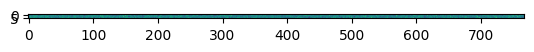

In [37]:
plt.imshow(topk_model.h[0].intermediate_outputs['post_ln1_residual'][0])

In [38]:
longest_shakespeare = get_top_n_tiny_shakespeare(1, mode="longest")[0]['Text']
longest_shakespeare

"Our king, being ready to leap out of\nhimself for joy of his found daughter, as if that\nOur king, being ready to leap out of\njoy were now become a loss, cries 'O, thy mother,\nthy mother!' then asks Bohemia forgiveness; then\nembraces his son-in-law; then again worries he his\ndaughter with clipping her; now he thanks the old\nshepherd, which stands by like a weather-bitten\nconduit of many kings' reigns. I never heard of such\nanother encounter, which lames report to follow it\nand undoes description to do it.\n\nSecond Gentleman:\nWhat, pray you, became of Antigonus, that carried\nhence the child?\n\nThird Gentleman:\nLike an old tale still, which will have matter to\nrehearse, though credit be asleep and not an ear\nopen. He was torn to pieces with a bear: this\navouches the shepherd's son; who has not only his\ninnocence, which seems much, to justify him, but a\nhandkerchief and rings of his that Paulina knows.\n\nFirst Gentleman:\nWhat became of his bark and his followers?\n\nT

In [39]:
input_ids = tokenizer.encode(longest_shakespeare, return_tensors="pt")
outputs = topk_model(input_ids)

In [40]:
h0_inter = topk_model.h[0].intermediate_outputs

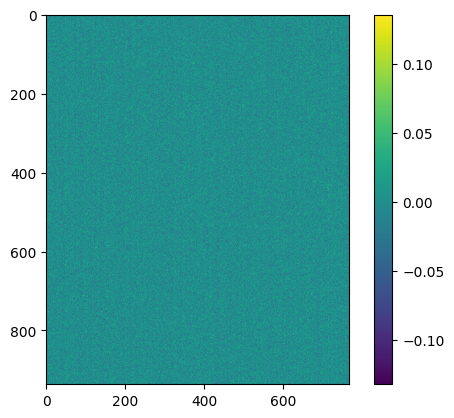

In [41]:
plt.imshow(topk_model.h[0].intermediate_outputs['post_ln1_residual'][0])
plt.colorbar()

In [42]:
h0_inter['attn_projection_output'].shape

torch.Size([1, 937, 768])

In [43]:
res = topk_model_with_gpt2_head(input_ids, output_attentions=True)

In [44]:
# res['attentions']

In [45]:
res['attentions'][0].shape

torch.Size([1, 12, 937, 937])

In [46]:
# res['attentions'][0]

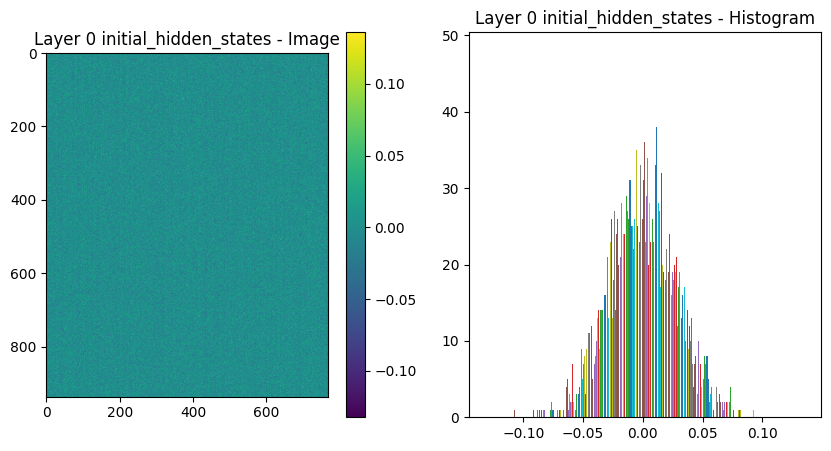

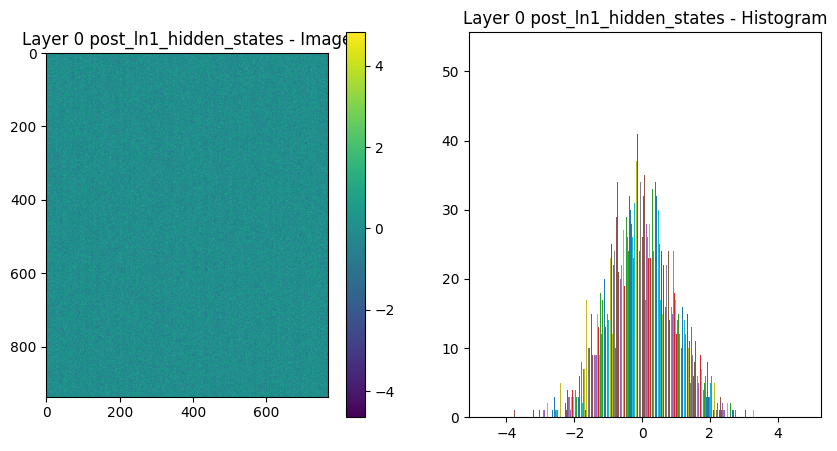

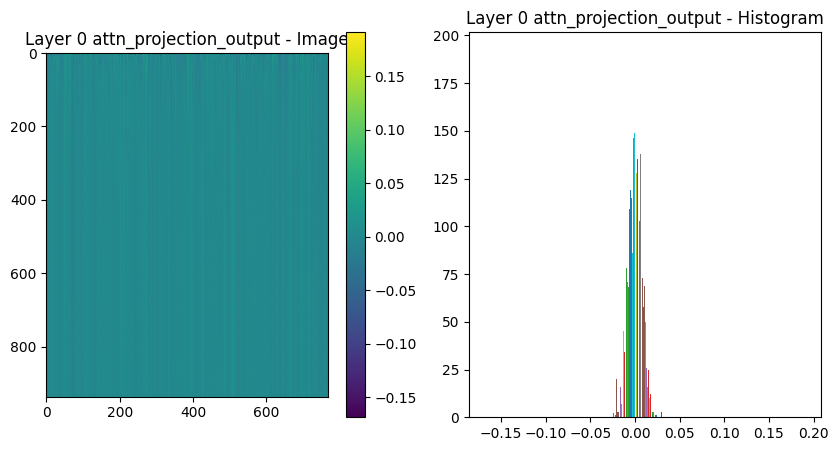

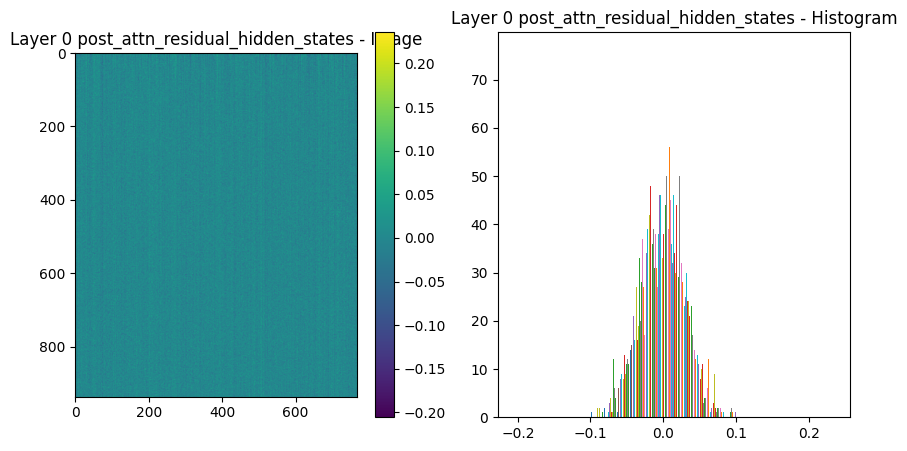

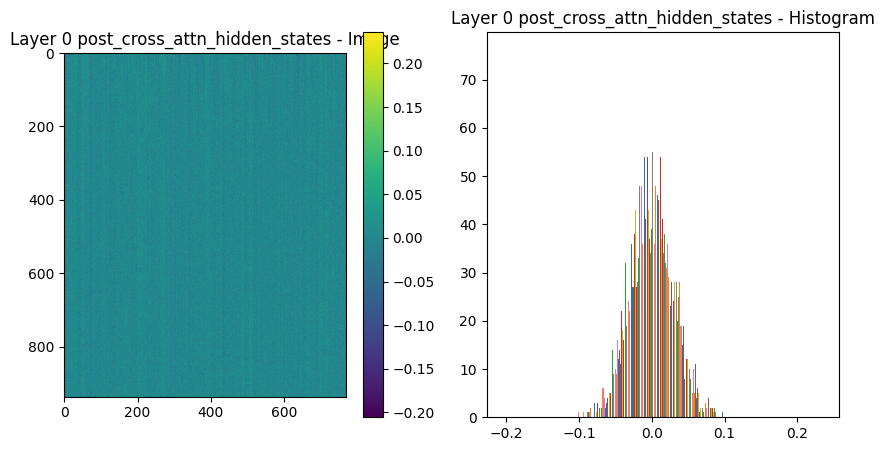

...

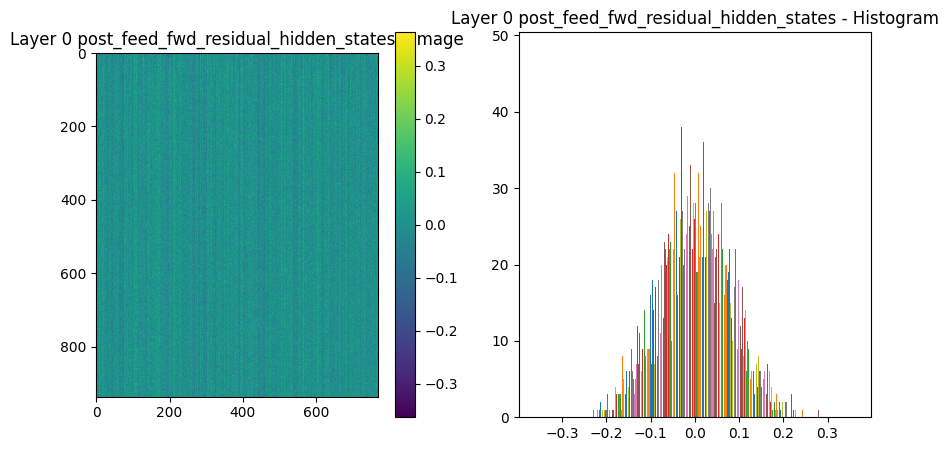

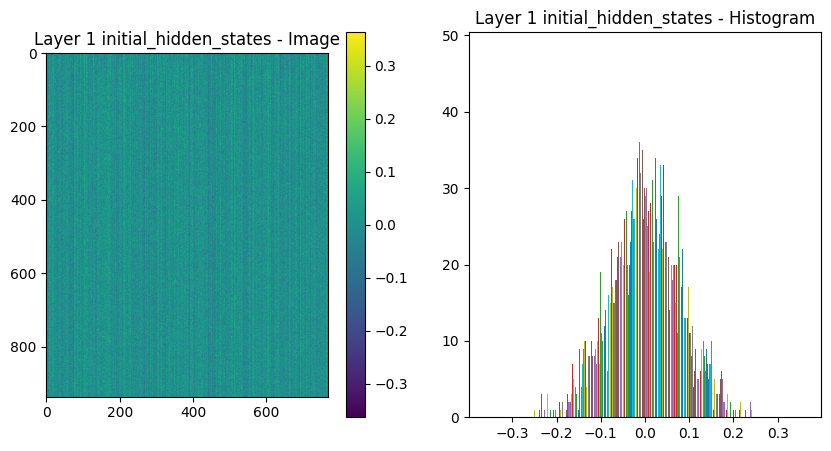

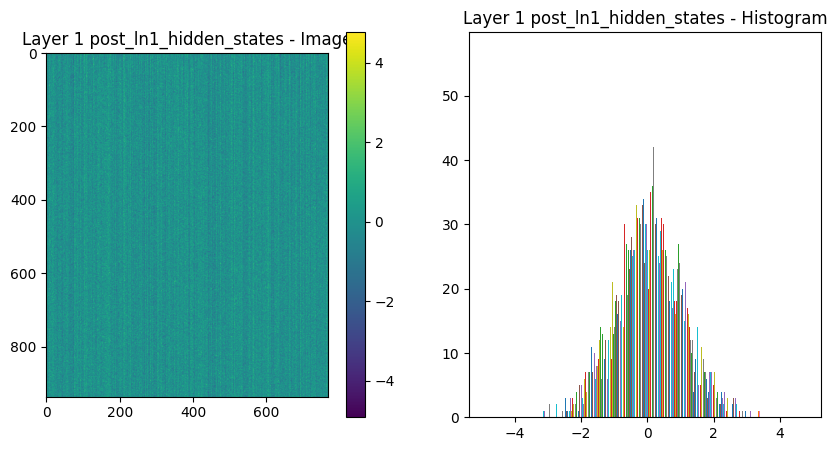

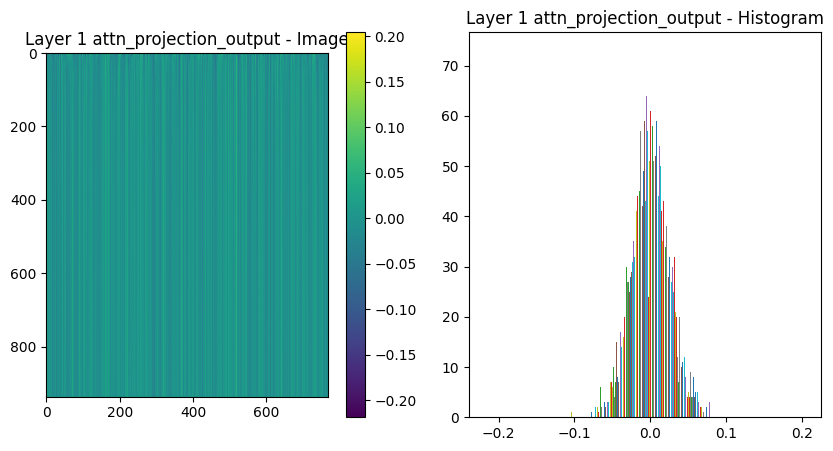

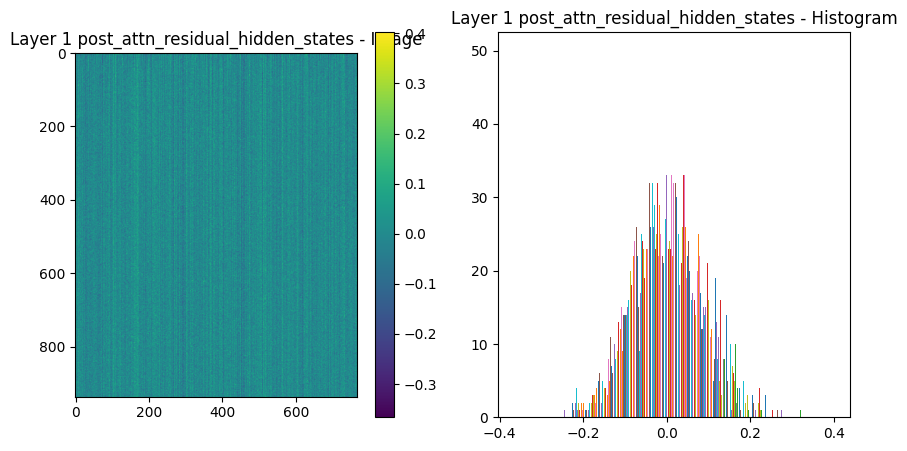

In [47]:
from utils.model import plot_intermediate_model_outputs

plot_intermediate_model_outputs(topk_model, hidden_state_keys)

## Second input prompt - shortest

So model is dependent on input length, even though we're plotting the supposedly independent TopKModel variable

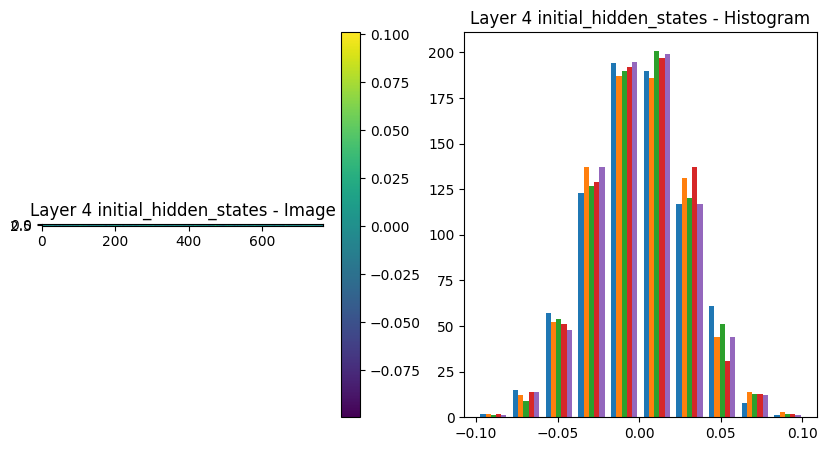

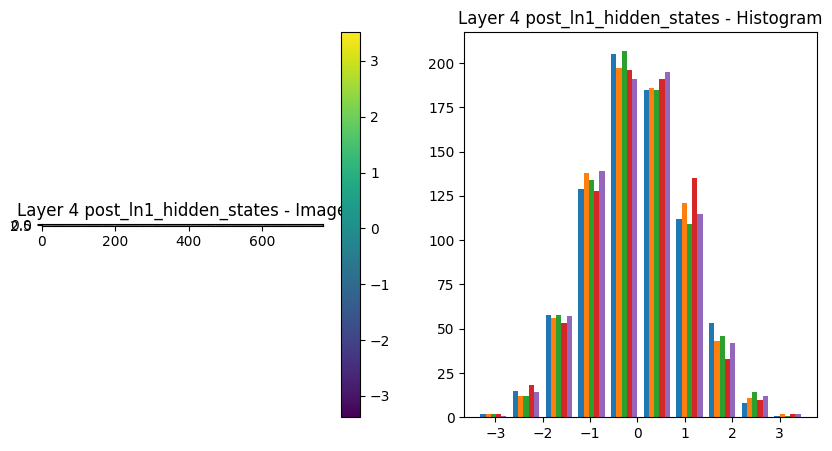

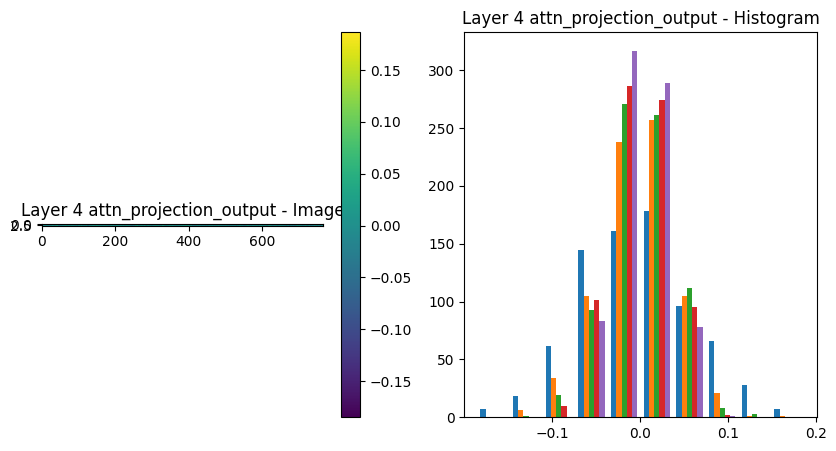

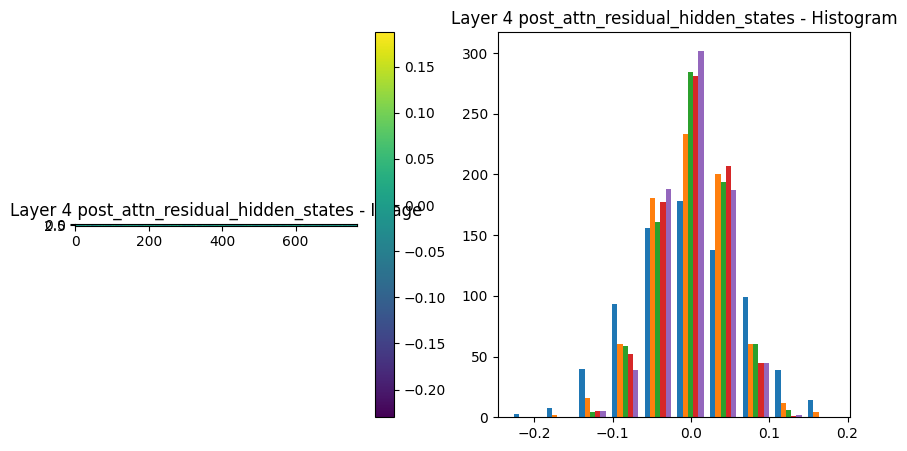

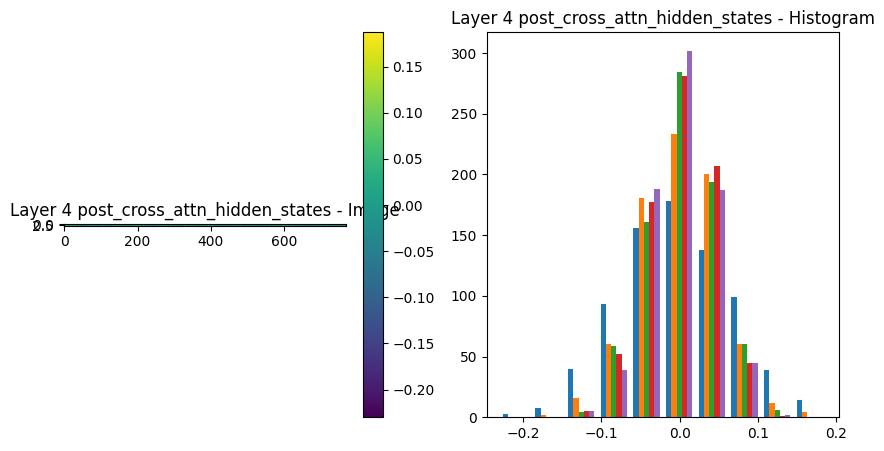

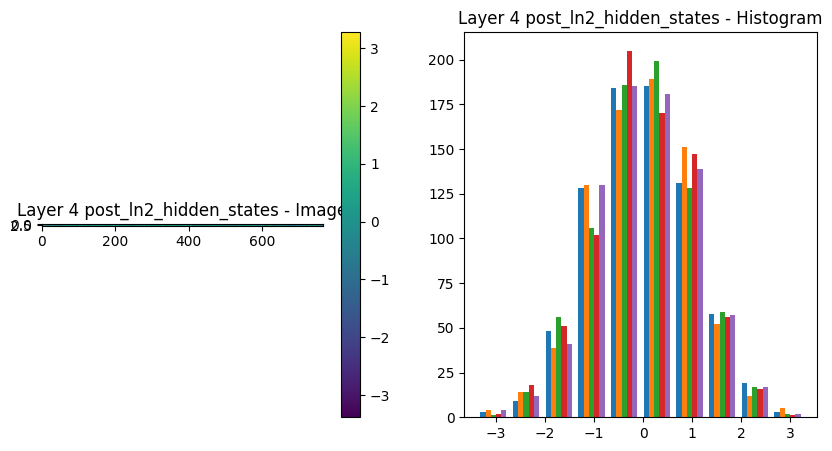

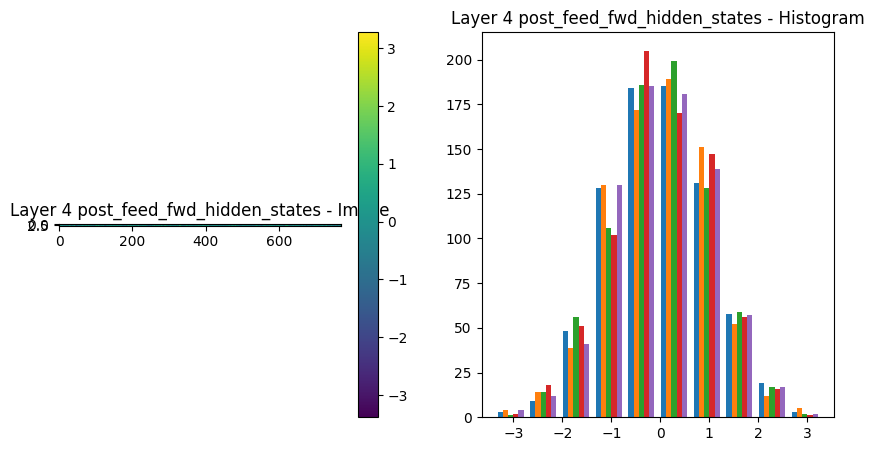

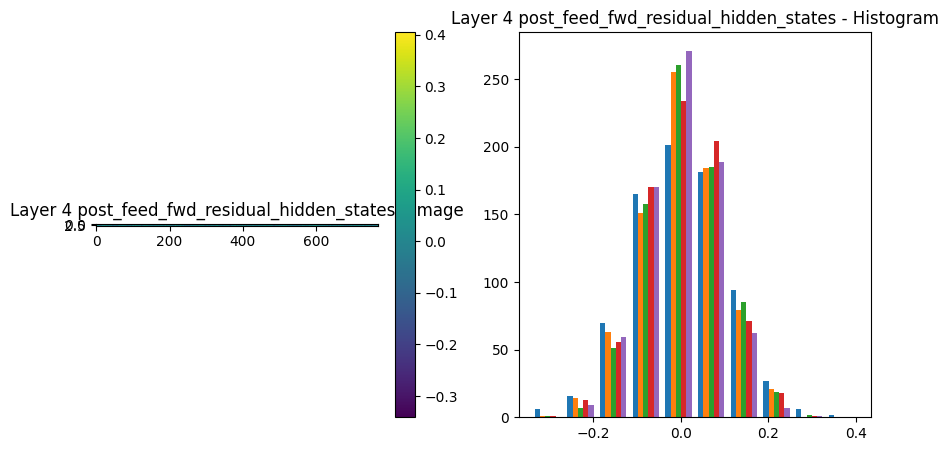

In [ ]:
input_ids = tokenizer.encode(get_top_n_tiny_shakespeare(1, mode="shortest")[0]['Text'], return_tensors="pt")
outputs = topk_model(input_ids)

# for i in range(len(topk_model.h)):
int_out = topk_model.h[0].intermediate_outputs
for key in hidden_state_keys:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    im = ax1.imshow(int_out[key][0])#, aspect='auto', interpolation='nearest')
    ax1.set_title(f'Layer {i} {key} - Image')
    ax1.figure.colorbar(im, ax=ax1)
    ax2.hist(int_out[key][0])#.ravel())#, bins=20, color='blue')
    ax2.set_title(f'Layer {i} {key} - Histogram')
    plt.show()

## Plot 2 next biggest prompts from TinyShakespeare

In [ ]:
get_top_n_tiny_shakespeare(3, mode="shortest")[1]['Text']

'DUCHESS OF YORK:\nSweet York, be patient.'

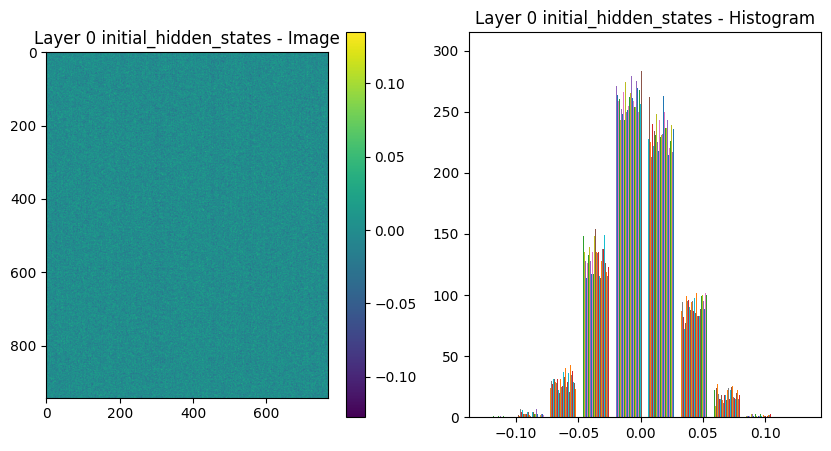

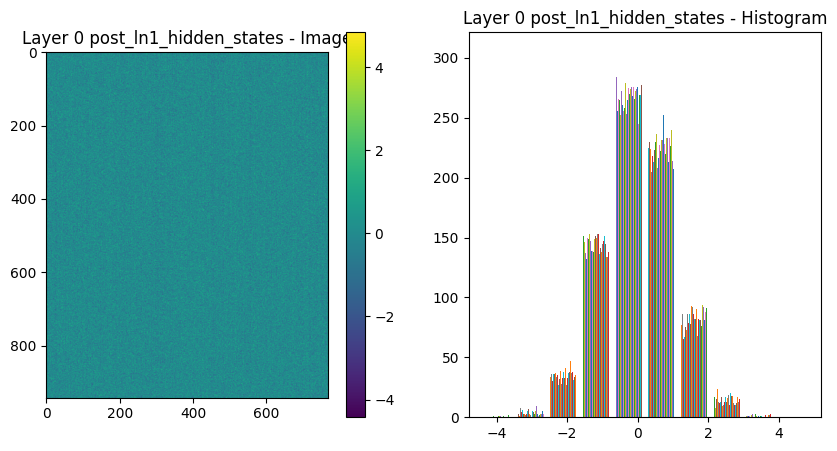

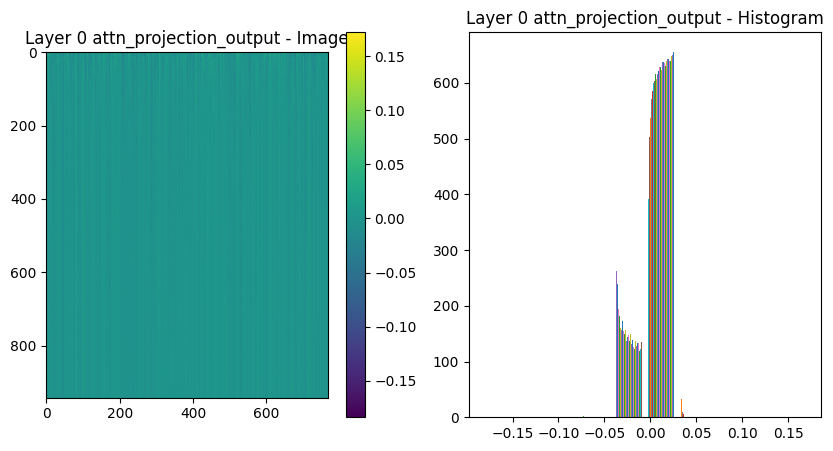

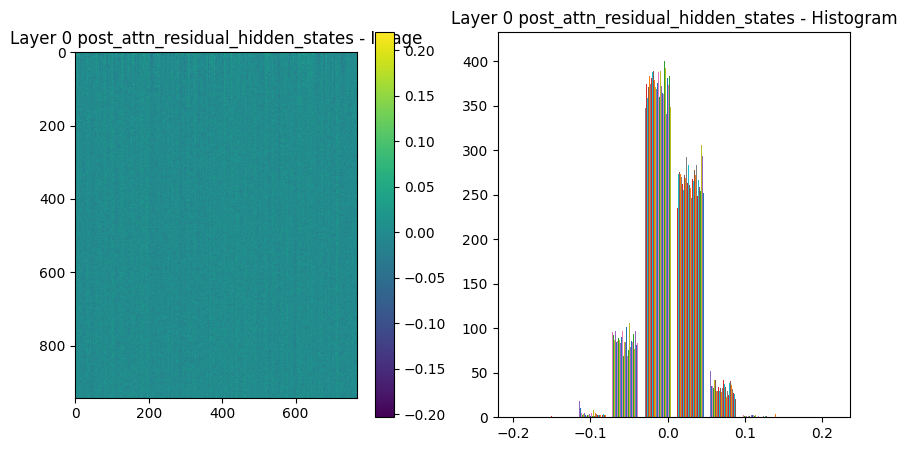

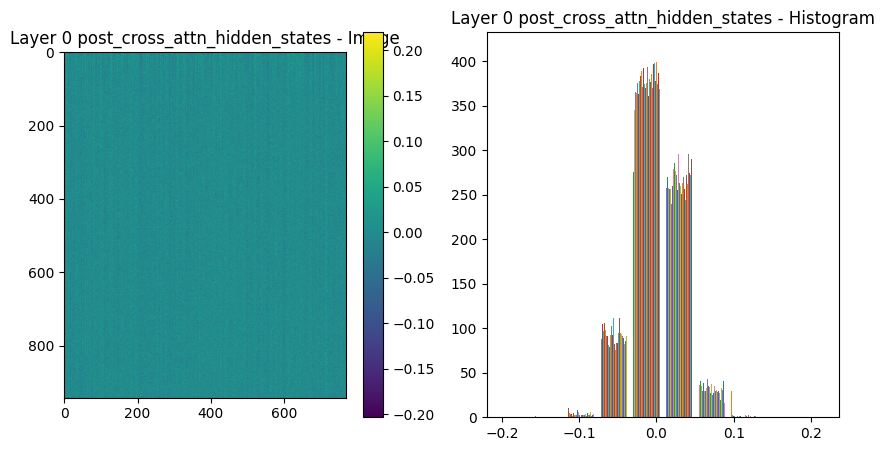

...

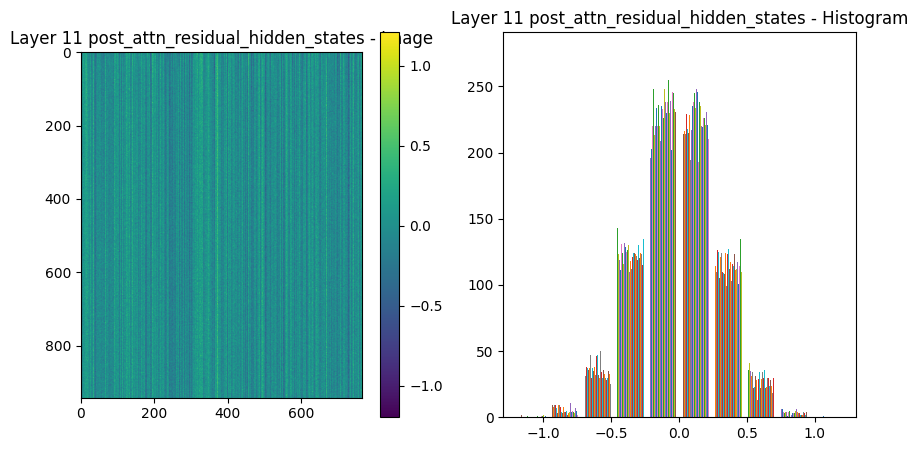

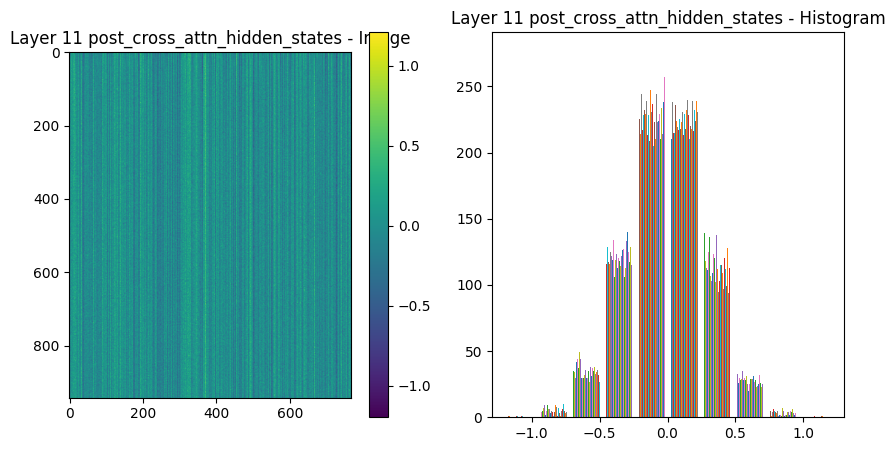

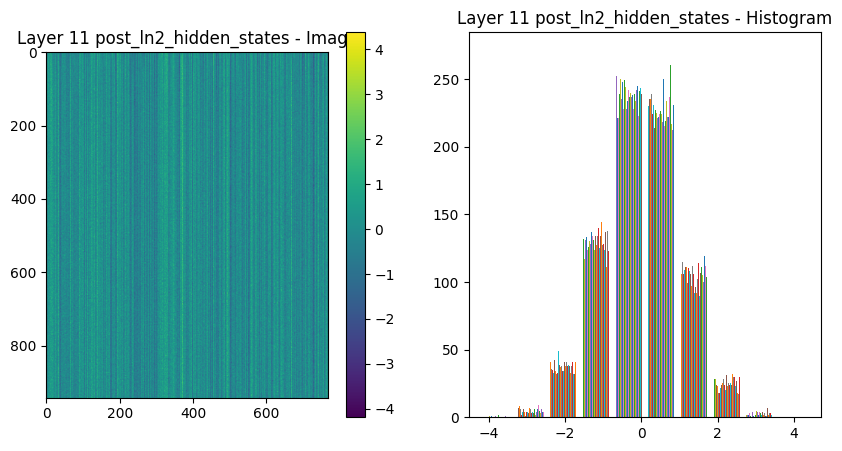

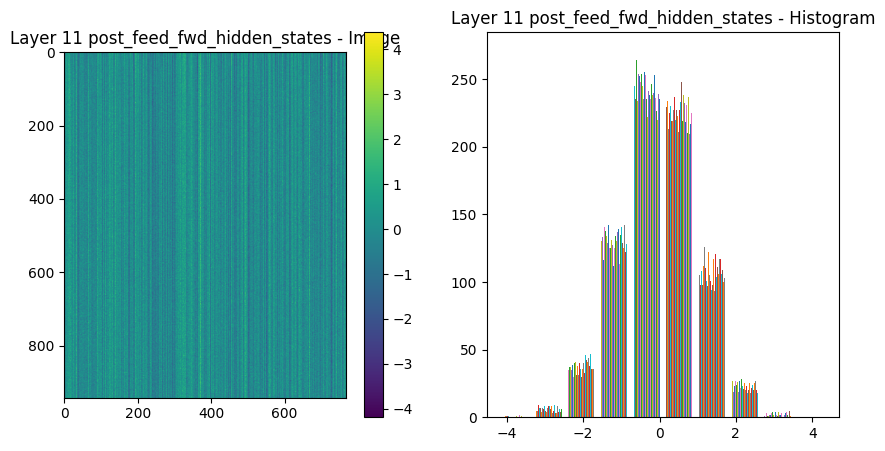

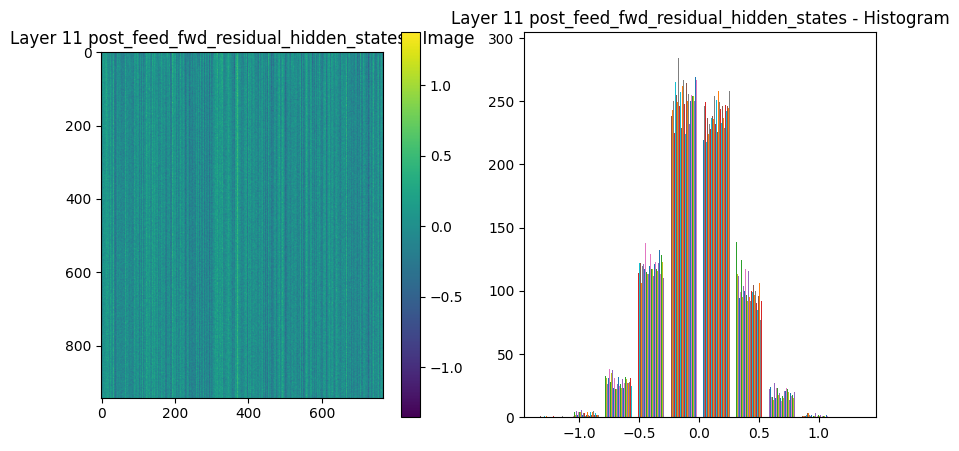

In [ ]:
second_longest = get_top_n_tiny_shakespeare(3, mode="longest")[1]['Text']
input_ids = tokenizer.encode(second_longest, return_tensors="pt")
outputs = topk_model(input_ids)

for i in range(len(topk_model.h)):
    int_out = topk_model.h[i].intermediate_outputs
    for key in hidden_state_keys:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
        im = ax1.imshow(int_out[key][0])#, aspect='auto', interpolation='nearest')
        ax1.set_title(f'Layer {i} {key} - Image')
        ax1.figure.colorbar(im, ax=ax1)
        ax2.hist(int_out[key][0])#.ravel())#, bins=20, color='blue')
        ax2.set_title(f'Layer {i} {key} - Histogram')
        plt.show()

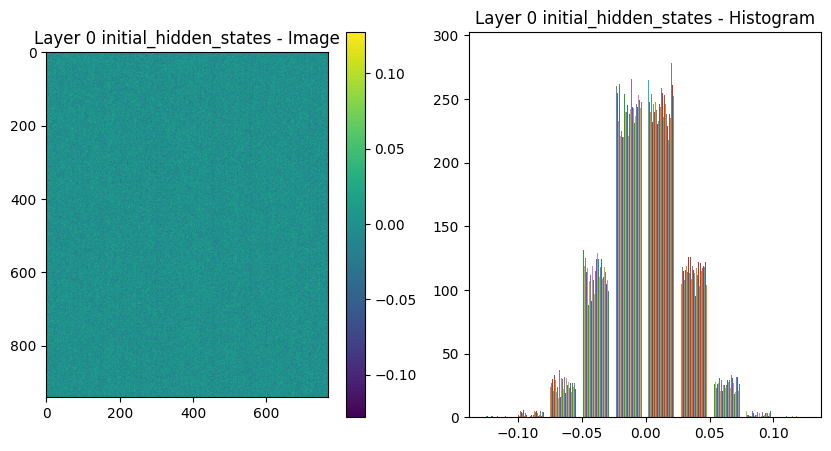

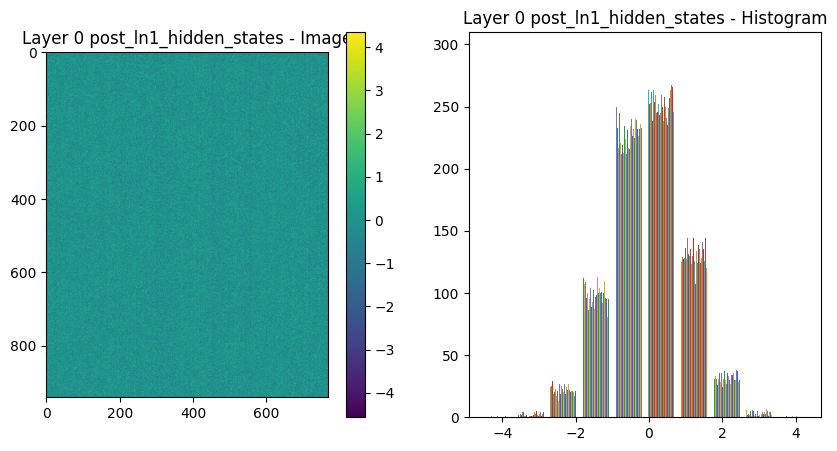

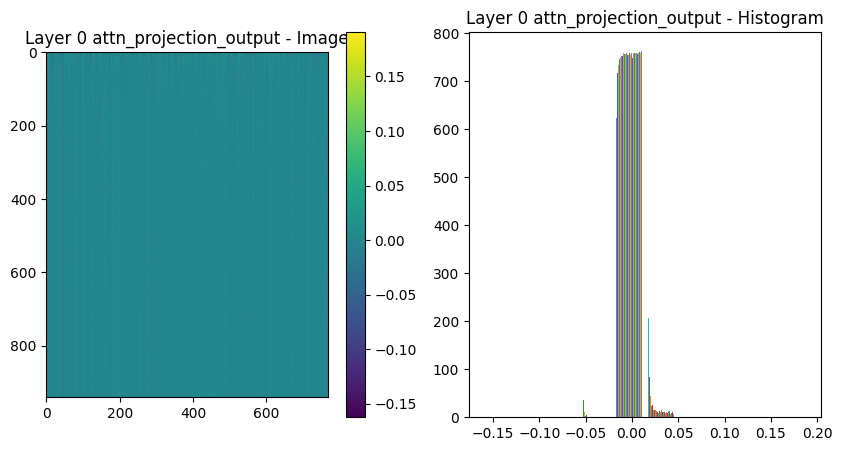

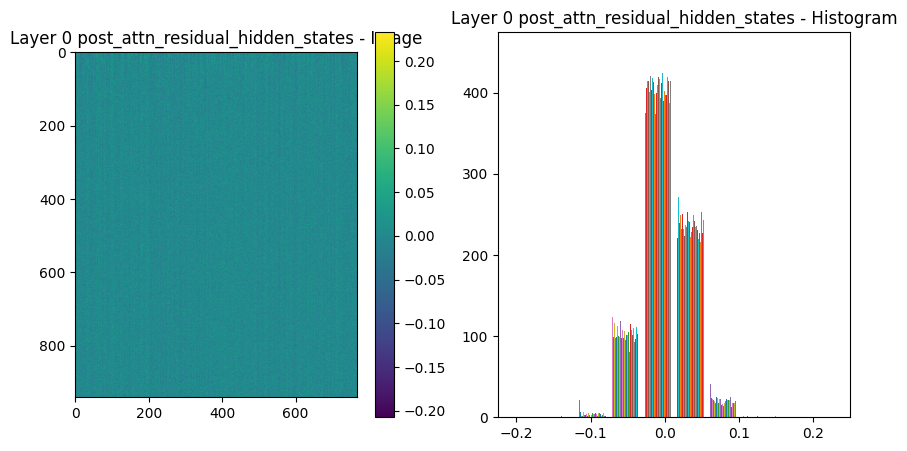

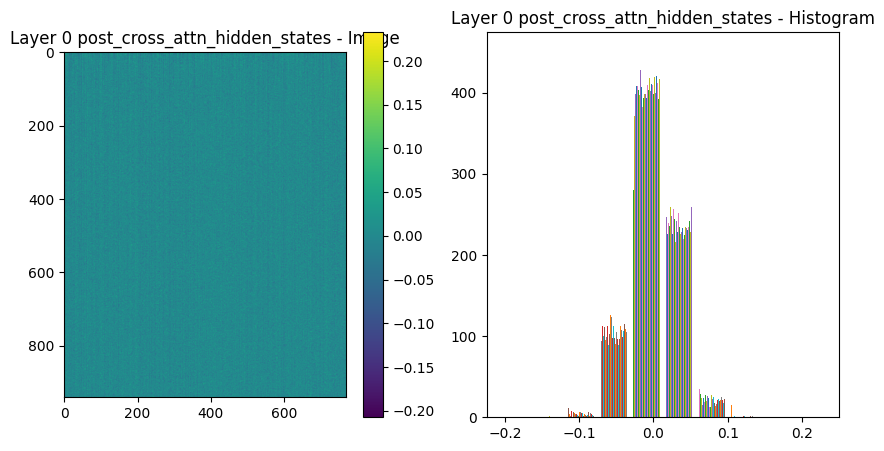

...

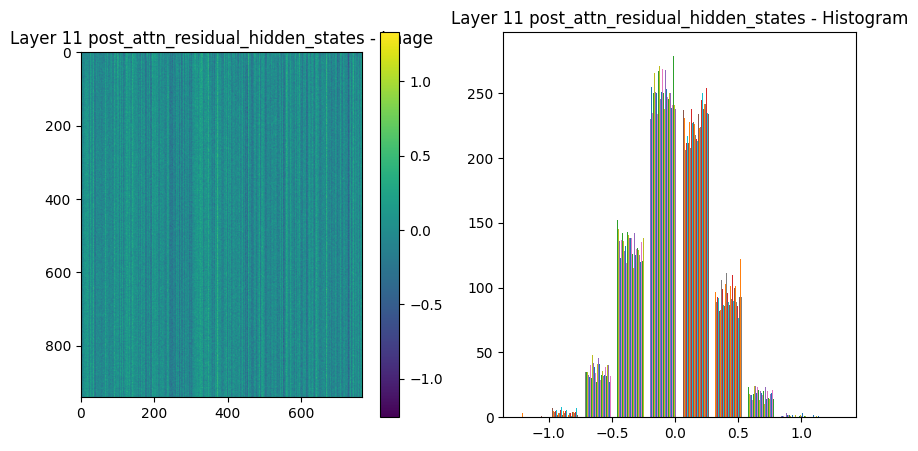

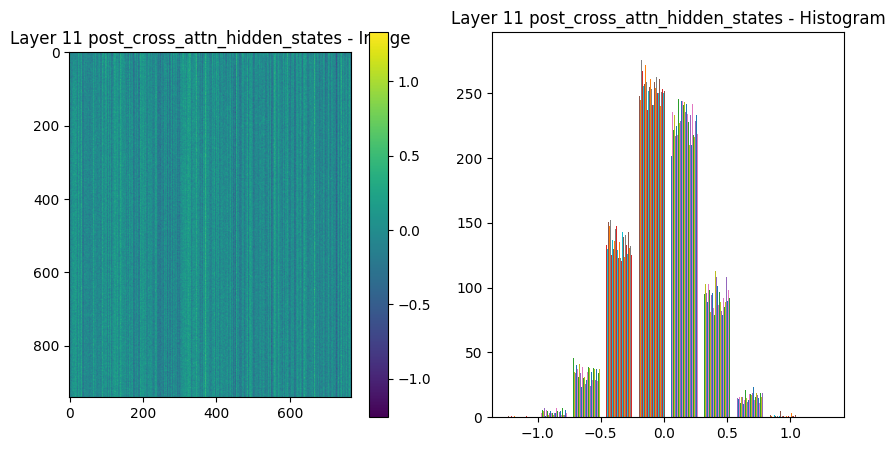

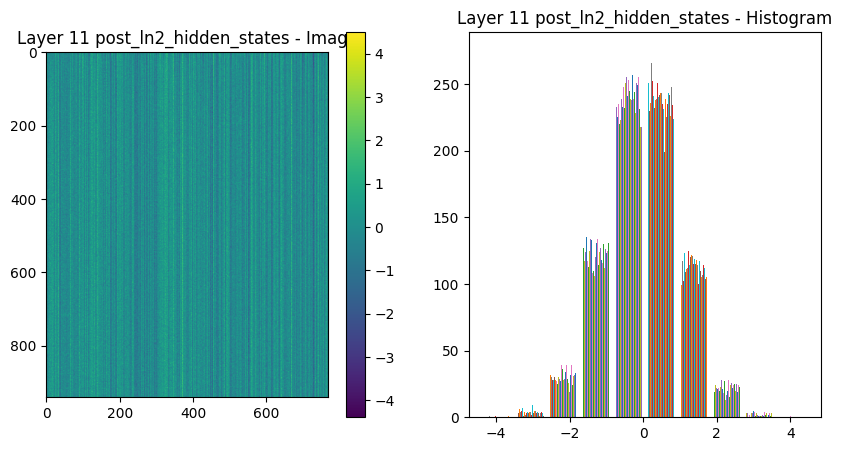

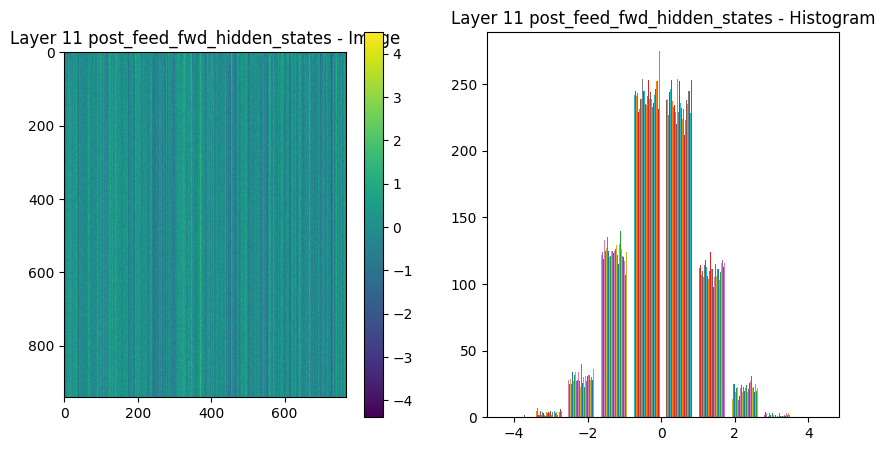

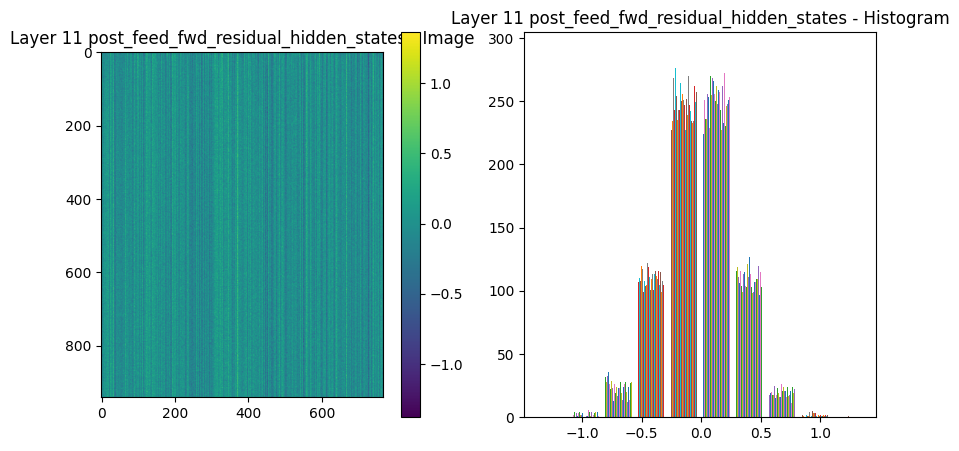

In [ ]:
second_longest = get_top_n_tiny_shakespeare(3, mode="longest")[2]['Text']
input_ids = tokenizer.encode(second_longest, return_tensors="pt")
outputs = topk_model(input_ids)

for i in range(len(topk_model.h)):
    int_out = topk_model.h[i].intermediate_outputs
    for key in hidden_state_keys:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
        im = ax1.imshow(int_out[key][0])#, aspect='auto', interpolation='nearest')
        ax1.set_title(f'Layer {i} {key} - Image')
        ax1.figure.colorbar(im, ax=ax1)
        ax2.hist(int_out[key][0])#.ravel())#, bins=20, color='blue')
        ax2.set_title(f'Layer {i} {key} - Histogram')
        plt.show()